## Preprocessing - Downscaling and finding Duplicates

In [1]:
## Importing Required Libraries

from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
import numpy as np
import imagehash
import PIL
import os

In [2]:
## creating a config class.

class CFG():
    threshold = .9
    img_size = 512
    seed = 42

In [3]:
## root path

root = 'plant-pathology-2021-fgvc8/train_images'
paths = os.listdir(root)

In [4]:
## downscaling the images for faster computation in training

df = pd.read_csv('plant-pathology-2021-fgvc8/train.csv', index_col='image')

for path in tqdm(paths, total=len(paths)):
    image = tf.io.read_file(os.path.join(root, path))
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, [CFG.img_size, CFG.img_size])
    image = tf.cast(image, tf.uint8).numpy()
    plt.imsave('/Users/yashwanth/Downloads/train_images_downscaled/'+path, image)


  0%|          | 0/18632 [00:00<?, ?it/s]

2023-03-27 21:56:36.938947: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2023-03-27 21:56:36.939310: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Metal device set to: Apple M1 Pro


In [5]:
root = '/Users/yashwanth/Downloads/train_images_downscaled/'
# paths = os.listdir(root)

## copmuting hashes

hash_functions = [
    imagehash.average_hash,
    imagehash.phash,
    imagehash.dhash,
    imagehash.whash]

## saving the hashes in a list.
image_ids = []
hashes = []

paths = tf.io.gfile.glob('plant-pathology-2021-fgvc8/train_images_downscaled/*.jpg')

for path in tqdm(paths, total=len(paths)):
    image = PIL.Image.open(path)
    hashes.append(np.array([x(image).hash for x in hash_functions]).reshape(-1,))
    image_ids.append(path.split('/')[-1])
    
hashes = np.array(hashes)
image_ids = np.array(image_ids)

  0%|          | 0/18632 [00:00<?, ?it/s]

In [6]:
# calculating the similarity of the images.

duplicate_ids = []

for i in tqdm(range(len(hashes)), total=len(hashes)):
    similarity = (hashes[i] == hashes).mean(axis=1)
    duplicate_ids.append(list(image_ids[similarity > CFG.threshold]))
    
duplicates = [frozenset([x] + y) for x, y in zip(image_ids, duplicate_ids)]
duplicates = set([x for x in duplicates if len(x) > 1])

  0%|          | 0/18632 [00:00<?, ?it/s]

In [7]:
## Saving the found duplicates
with open('duplicates.csv', 'w') as file:
    for row in duplicates:
        file.write(','.join(row) + '\n')

In [8]:
len(duplicates)

50

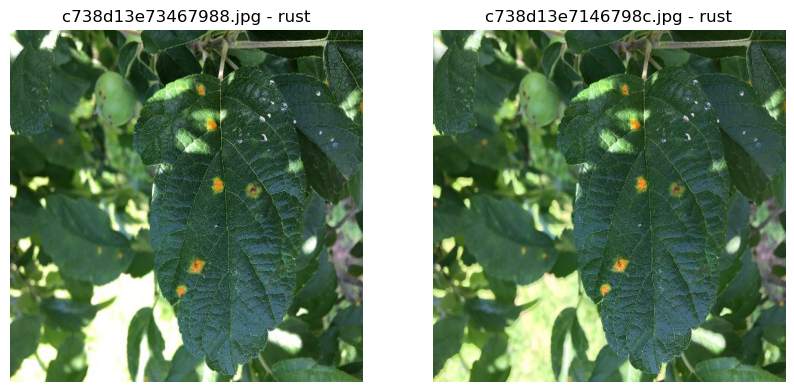

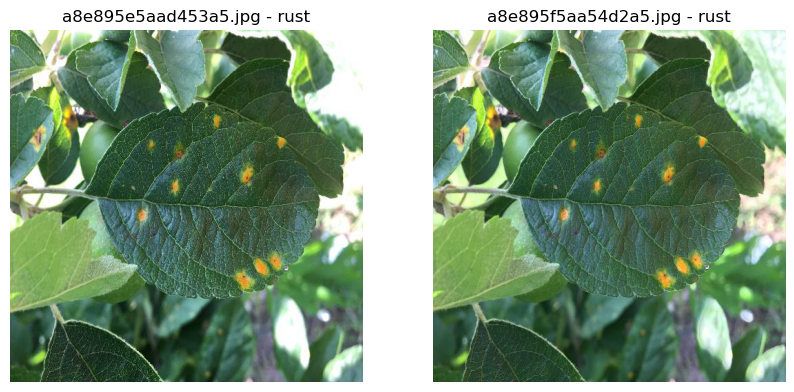

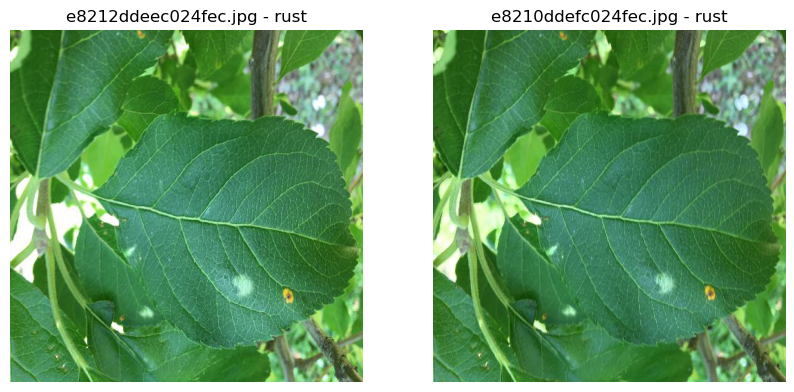

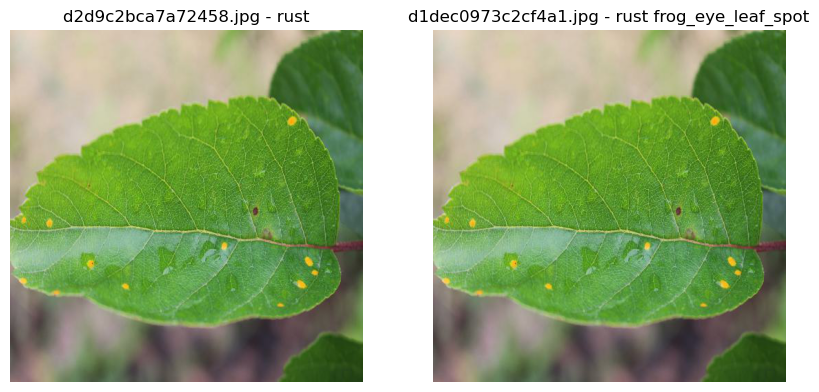

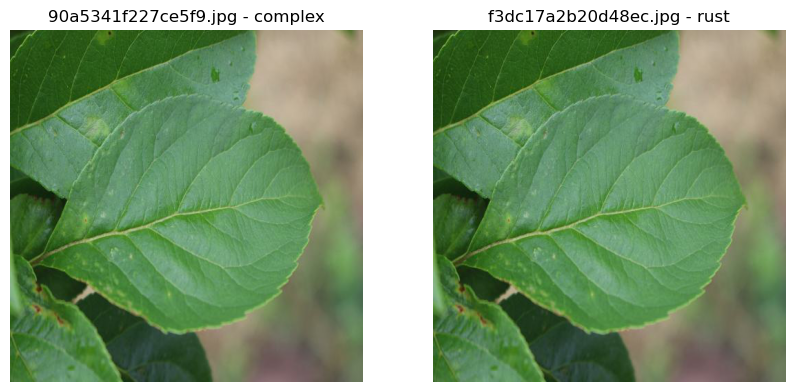

...

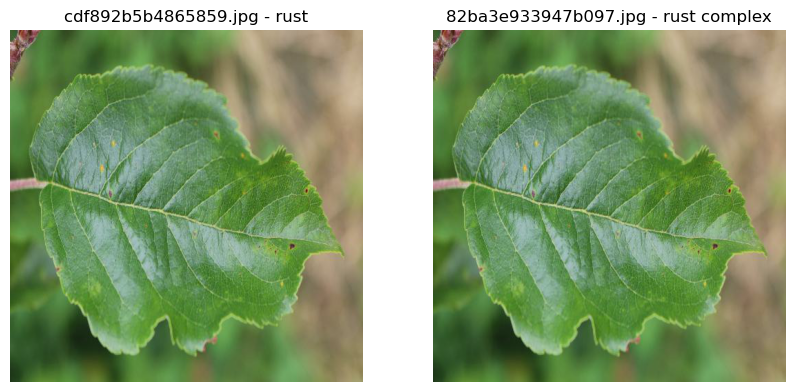

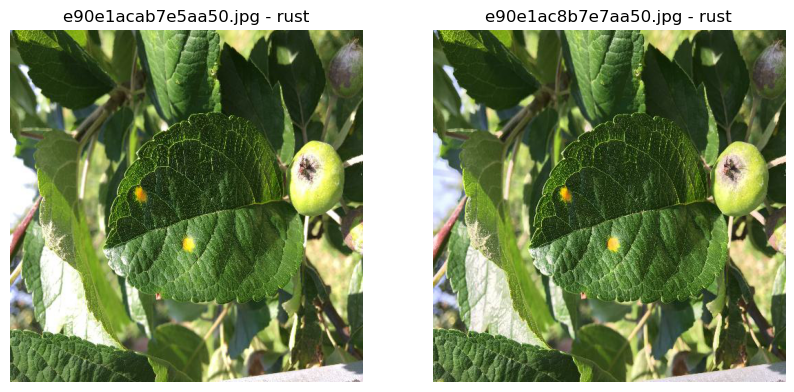

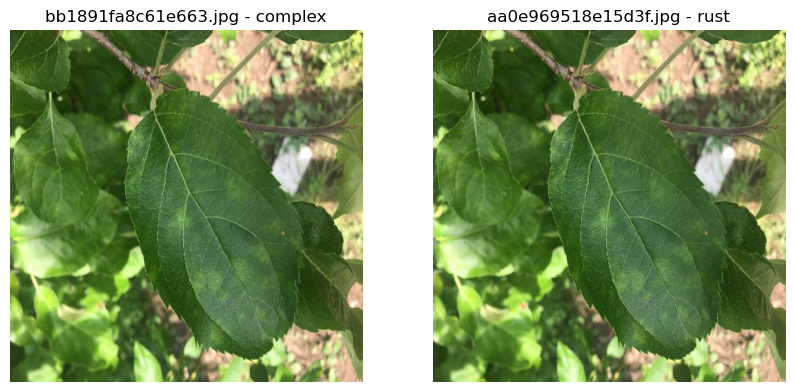

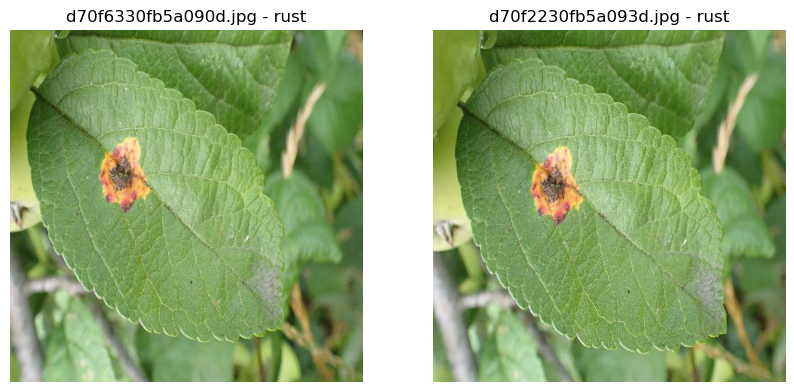

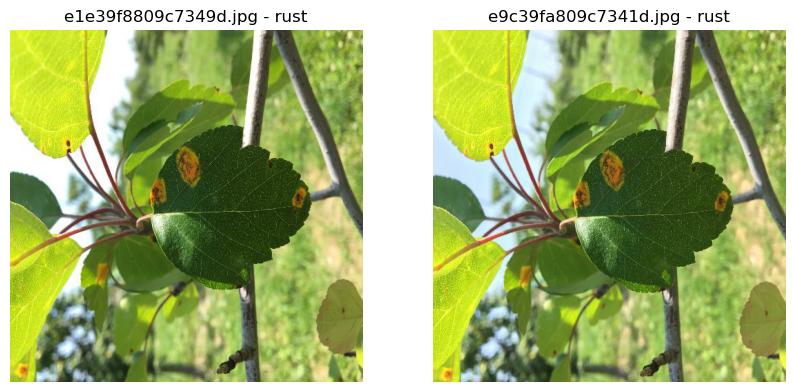

In [9]:
for row in duplicates:
    
    figure, axes = plt.subplots(1, len(row), figsize=[5 * len(row), 5])

    for i, image_id in enumerate(row):
        image = plt.imread(os.path.join('/Users/yashwanth/Downloads/train_images_downscaled/', image_id))
        axes[i].imshow(image)

        axes[i].set_title(f'{image_id} - {df.loc[image_id, "labels"]}')
        axes[i].axis('off')

    plt.show()